# This notebook is used to identify domains using banksy

In [10]:
import warnings
warnings.filterwarnings("ignore") 
import os, time
import pandas as pd
import numpy as np
import random
import scipy.sparse as sparse
from scipy.sparse import csr_matrix, issparse
import scanpy as sc
import matplotlib.pyplot as plt
os.chdir('/home/sergio/Banksy_py')
from banksy.initialize_banksy import initialize_banksy
from banksy.run_banksy import run_banksy_multiparam
from utils.color_lists import spagcn_color
start = time.perf_counter_ns()
random_seed = 1234
cluster_algorithm = 'leiden'
np.random.seed(random_seed)
random.seed(random_seed)
os.chdir('/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/notebooks/architecture_exploration')

# Load data

In [13]:
saving_path=r'../../data/processed_adata/'
adata=sc.read('../../data/processed_adata/adata_multisection_nuclei_r1_with_annotations.h5ad')
adata=adata[adata.obs['replicate']=='1']
adata.X=adata.layers['raw']
adata.obsm['spatial']=np.array(adata.obs.loc[:,['x_centroid','y_centroid']])

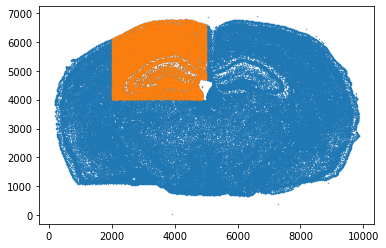

In [14]:
adata2=adata[(adata.obs['x_centroid']<5000)&(adata.obs['x_centroid']>2000)&(adata.obs['y_centroid']>4000)]
plt.scatter(adata.obs.loc[:,'x_centroid'],adata.obs.loc[:,'y_centroid'],s=0.1)
plt.scatter(adata2.obs.loc[:,'x_centroid'],adata2.obs.loc[:,'y_centroid'],s=0.1)
adata=adata2
ndoms=[]
for num in range(1,5):
    ndoms.append(len(np.unique(adata.obs['region_level'+str(num)])))

In [22]:
from utils.load_data import load_adata

'''Main tunable variation in running the BANKSY algorithm'''

'''Input File'''
file_path = os.path.join("data", "starmap")
adata_filename = "starmap_BY3_1k.h5ad"

gcm_filename = ""
locations_filename = ""

load_adata_directly = True

'''Saving output figures'''
save_fig = False

output_folder = os.path.join(os.getcwd(), 'data', 'starmap', 'tmp_png', f'{cluster_algorithm}', f'seed{random_seed}')

# Colour map
c_map = 'tab20'

coord_keys = ('x', 'y', 'spatial')
num_clusters = 7
sample = 'starmap'

adata.var_names_make_unique()

manual_labels =  "smoothed_manual" # Ground truth annotations in pd.DataFrame
annotation_key = "Class" # Key to access annotations in adata.obs[annotation_keys]

In [ ]:
'''Load manual annotations'''
adata = adata[adata.obs["cluster_name"].notnull()]

annotations =  pd.read_csv(os.path.join(file_path, "Starmap_BY3_1k_meta_annotated_18oct22.csv"))


print(annotations.loc[:,manual_labels ])
adata.obs[annotation_key] = annotations.loc[:,manual_labels ].values
adata.obs[annotation_key] = adata.obs[annotation_key].astype('category')
print(adata.obs[annotation_key])

# Add spatial coordinates to '.obsm' attribute
adata.obsm[coord_keys[2]] = pd.concat([adata.obs[coord_keys[0]], adata.obs[coord_keys[1]]], axis=1).to_numpy()

In [18]:
resolutions = [.9] # clustering resolution for Leiden clustering
pca_dims = [20] # number of dimensions to keep after PCA
lambda_list = [.8] # lambda
k_geom = 15 # 15 spatial neighbours
max_m = 1 # use AGF
nbr_weight_decay = "scaled_gaussian" # can also be "reciprocal", "uniform" or "ranked"

In [62]:
resolutions = [2.0] # clustering resolution for Leiden clustering


Median distance to closest cell = 11.882226450988238

---- Ran median_dist_to_nearest_neighbour in 0.07 s ----

---- Ran generate_spatial_distance_graph in 0.13 s ----

---- Ran row_normalize in 0.11 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 0.96 s ----

----- Plotting Edge Histograms for m = 0 -----

Edge weights (distances between cells): median = 24.723816453809235, mode = 16.75154555387961

---- Ran plot_edge_histogram in 0.06 s ----


Edge weights (weights between cells): median = 0.059152362975490085, mode = 0.032144700100200575

---- Ran plot_edge_histogram in 0.06 s ----

---- Ran generate_spatial_distance_graph in 0.20 s ----

---- Ran theta_from_spatial_graph in 0.23 s ----

---- Ran row_normalize in 0.11 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 1.29 s ----

----- Plotting Edge Histograms for m = 1 -----

Edge weights (distances between cells): median = 34.58214972422875, mode = 23.65948110729368

---- Ran plot_edge_histogram in 0.07 s ----


Edg

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.00,scaled_gaussian,0.8,20,2.0,24,"Label object:\nNumber of labels: 24, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.306233


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-17

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.05,scaled_gaussian,0.8,20,2.05,24,"Label object:\nNumber of labels: 24, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.316499


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-18

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.10,scaled_gaussian,0.8,20,2.1,26,"Label object:\nNumber of labels: 26, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.293795


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-18

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.15,scaled_gaussian,0.8,20,2.15,25,"Label object:\nNumber of labels: 25, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.315942


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-19

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.20,scaled_gaussian,0.8,20,2.2,26,"Label object:\nNumber of labels: 26, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.309995


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-19

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.25,scaled_gaussian,0.8,20,2.25,27,"Label object:\nNumber of labels: 27, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.303197


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-19

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.30,scaled_gaussian,0.8,20,2.3,26,"Label object:\nNumber of labels: 26, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.318535


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-20

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.35,scaled_gaussian,0.8,20,2.35,27,"Label object:\nNumber of labels: 27, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.315802


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-20

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.40,scaled_gaussian,0.8,20,2.4,27,"Label object:\nNumber of labels: 27, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.302818


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-21

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.45,scaled_gaussian,0.8,20,2.45,27,"Label object:\nNumber of labels: 27, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.288766


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-21

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.50,scaled_gaussian,0.8,20,2.5,28,"Label object:\nNumber of labels: 28, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.29032


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-21

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.55,scaled_gaussian,0.8,20,2.55,30,"Label object:\nNumber of labels: 30, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.266035


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-22

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.60,scaled_gaussian,0.8,20,2.6,29,"Label object:\nNumber of labels: 29, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.264028


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-22

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.65,scaled_gaussian,0.8,20,2.65,29,"Label object:\nNumber of labels: 29, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.27237


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-23

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.70,scaled_gaussian,0.8,20,2.7,31,"Label object:\nNumber of labels: 31, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.268321


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-23

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.75,scaled_gaussian,0.8,20,2.75,30,"Label object:\nNumber of labels: 30, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.265964


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-24

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.80,scaled_gaussian,0.8,20,2.8,31,"Label object:\nNumber of labels: 31, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.264327


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-24

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.85,scaled_gaussian,0.8,20,2.85,31,"Label object:\nNumber of labels: 31, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.269979


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-24

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.90,scaled_gaussian,0.8,20,2.9,32,"Label object:\nNumber of labels: 32, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.263693


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-25

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r2.95,scaled_gaussian,0.8,20,2.95,32,"Label object:\nNumber of labels: 32, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.259592


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-25

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.00,scaled_gaussian,0.8,20,3.0,33,"Label object:\nNumber of labels: 33, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.264766


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-26

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.05,scaled_gaussian,0.8,20,3.05,34,"Label object:\nNumber of labels: 34, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.266023


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-26

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.10,scaled_gaussian,0.8,20,3.1,34,"Label object:\nNumber of labels: 34, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.259336


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-26

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.15,scaled_gaussian,0.8,20,3.15,33,"Label object:\nNumber of labels: 33, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.25527


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-27

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.20,scaled_gaussian,0.8,20,3.2,35,"Label object:\nNumber of labels: 35, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.246202


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-27

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.25,scaled_gaussian,0.8,20,3.25,35,"Label object:\nNumber of labels: 35, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.257617


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-28

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.30,scaled_gaussian,0.8,20,3.3,36,"Label object:\nNumber of labels: 36, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.240989


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-28

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.35,scaled_gaussian,0.8,20,3.35,35,"Label object:\nNumber of labels: 35, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.238709


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-29

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.40,scaled_gaussian,0.8,20,3.4,36,"Label object:\nNumber of labels: 36, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.230818


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-29

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.45,scaled_gaussian,0.8,20,3.45,37,"Label object:\nNumber of labels: 37, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.234861


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-29

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.50,scaled_gaussian,0.8,20,3.5,36,"Label object:\nNumber of labels: 36, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.25367


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-30

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.55,scaled_gaussian,0.8,20,3.55,40,"Label object:\nNumber of labels: 40, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.23198


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-30

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.60,scaled_gaussian,0.8,20,3.6,39,"Label object:\nNumber of labels: 39, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.240674


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-31

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.65,scaled_gaussian,0.8,20,3.65,38,"Label object:\nNumber of labels: 38, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.238684


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-31

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.70,scaled_gaussian,0.8,20,3.7,39,"Label object:\nNumber of labels: 39, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.231784


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-32

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.75,scaled_gaussian,0.8,20,3.75,41,"Label object:\nNumber of labels: 41, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.232203


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-32

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.80,scaled_gaussian,0.8,20,3.8,39,"Label object:\nNumber of labels: 39, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.236176


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-32

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.85,scaled_gaussian,0.8,20,3.85,39,"Label object:\nNumber of labels: 39, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.221155


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-33

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.90,scaled_gaussian,0.8,20,3.9,41,"Label object:\nNumber of labels: 41, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.22005


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-33

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r3.95,scaled_gaussian,0.8,20,3.95,43,"Label object:\nNumber of labels: 43, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.223645


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-34

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r4.00,scaled_gaussian,0.8,20,4.0,42,"Label object:\nNumber of labels: 42, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.223634


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-34

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r4.05,scaled_gaussian,0.8,20,4.05,41,"Label object:\nNumber of labels: 41, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.22994


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-35

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r4.10,scaled_gaussian,0.8,20,4.1,43,"Label object:\nNumber of labels: 43, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.216321


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-35

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r4.15,scaled_gaussian,0.8,20,4.15,43,"Label object:\nNumber of labels: 43, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.218127


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-35

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r4.20,scaled_gaussian,0.8,20,4.2,44,"Label object:\nNumber of labels: 44, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.212105


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-36

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r4.25,scaled_gaussian,0.8,20,4.25,43,"Label object:\nNumber of labels: 43, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.22326


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-36

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r4.30,scaled_gaussian,0.8,20,4.3,45,"Label object:\nNumber of labels: 45, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.214214


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-37

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r4.35,scaled_gaussian,0.8,20,4.35,45,"Label object:\nNumber of labels: 45, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.216297


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-37

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r4.40,scaled_gaussian,0.8,20,4.4,47,"Label object:\nNumber of labels: 47, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.210539


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-38

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r4.45,scaled_gaussian,0.8,20,4.45,47,"Label object:\nNumber of labels: 47, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.212468


Anndata AxisArrays with keys: reduced_pc_20
Runtime Nov-10-2023-09-38

248 genes to be analysed:
Gene List:
Index(['2010300C02Rik', 'Acsbg1', 'Acta2', 'Acvrl1', 'Adamts2', 'Adamtsl1',
       'Adgrl4', 'Aldh1a2', 'Angpt1', 'Ano1',
       ...
       'Trp73', 'Trpc4', 'Unc13c', 'Vat1l', 'Vip', 'Vwc2l', 'Wfs1', 'Zfp366',
       'Zfp536', 'Zfpm2'],
      dtype='object', name='gene_id', length=248)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <24385x24385 sparse matrix of type '<class 'numpy.float64'>'
	with 365775 stored elements in Compressed Sparse Row format>, 1: <24385x24385 sparse matrix of type '<class 'numpy.complex128'>'
	with 731550 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[1.        , 6.        , 0.        , ..., 0.07462876, 0.3559987 ,
        0.01328751],
       [0.        , 0.        , 0.        , ..., 0.03963459, 0.3658629 ,
        0.04283597],
       [0.        , 2.        , 1.        , ..., 0.08240657, 0.55751216,

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,ari
scaled_gaussian_pc20_nc0.80_r4.50,scaled_gaussian,0.8,20,4.5,49,"Label object:\nNumber of labels: 49, number of...",[[[View of AnnData object with n_obs × n_vars ...,0.207289


Anndata AxisArrays with keys: reduced_pc_20


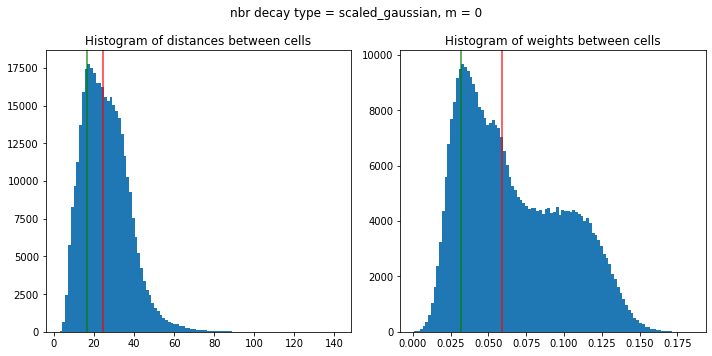

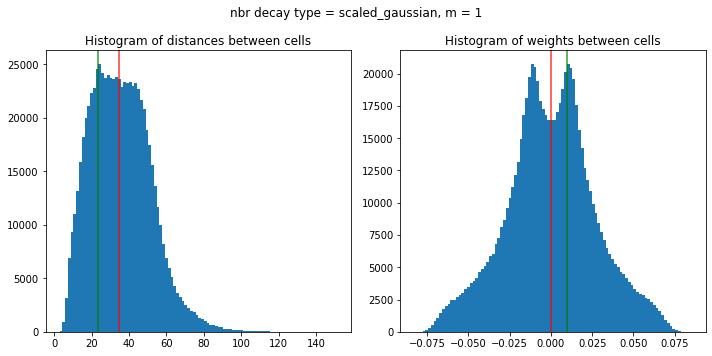

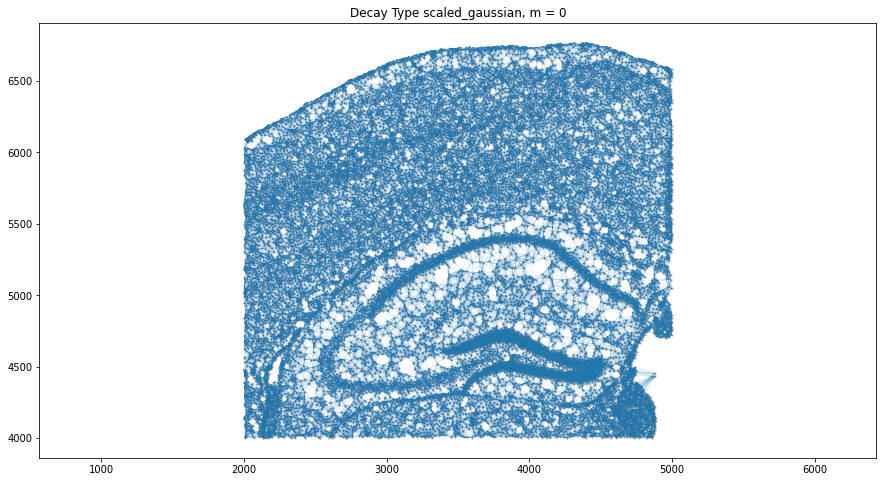

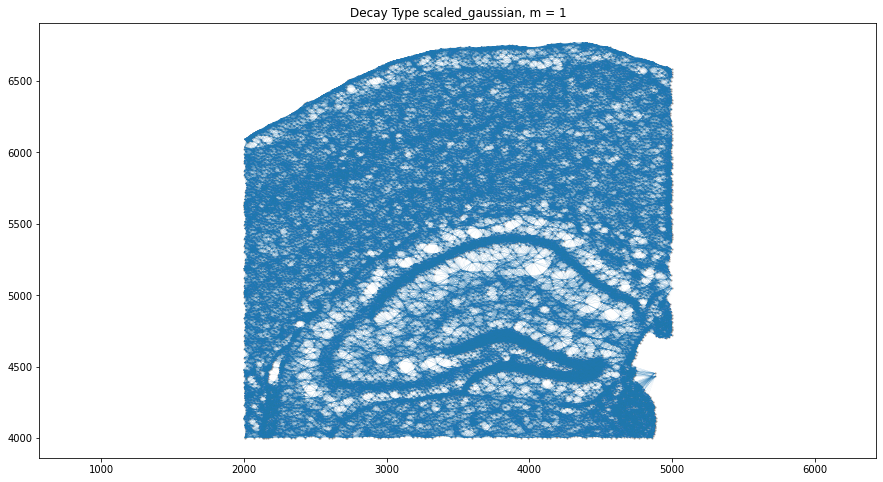

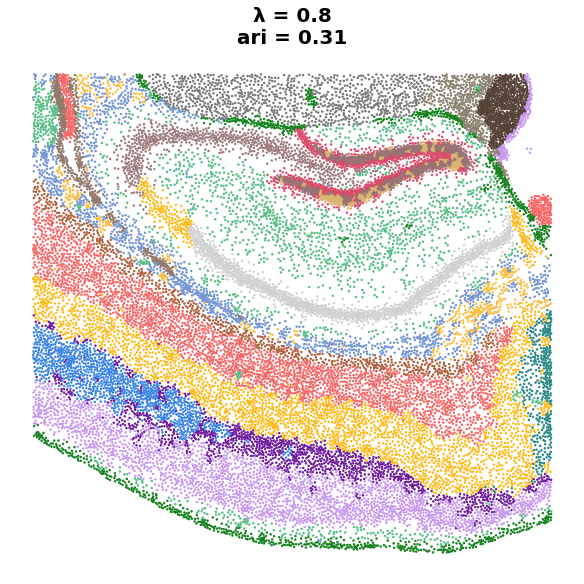

...

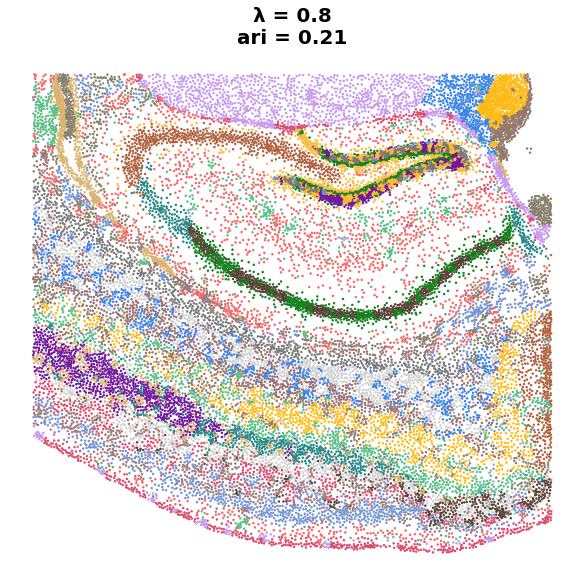

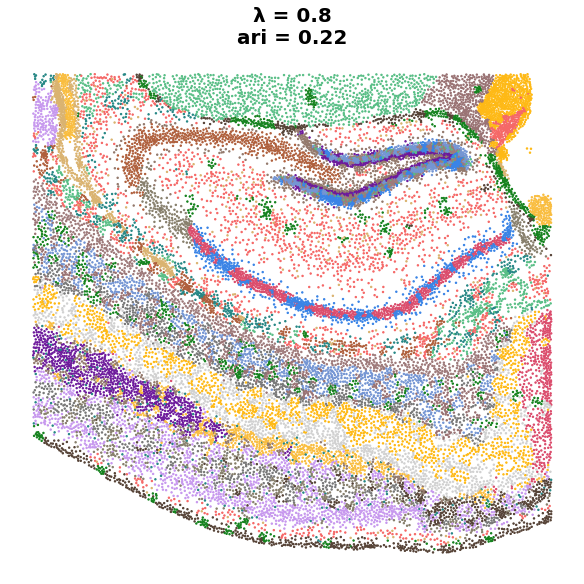

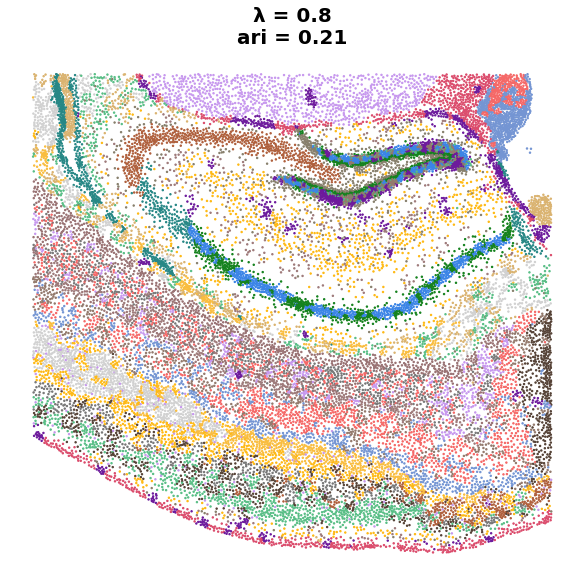

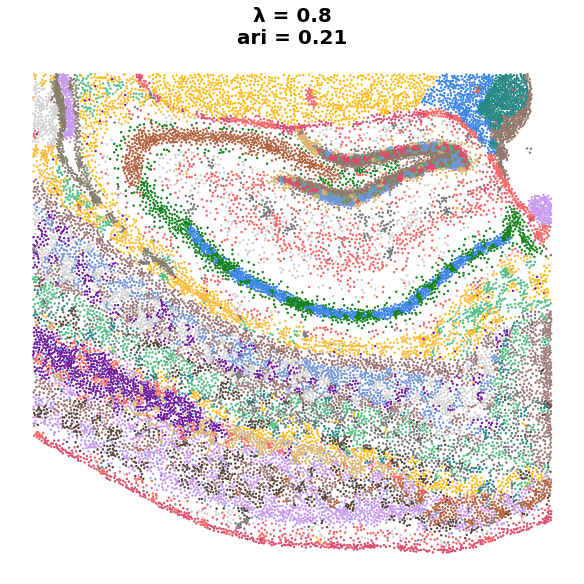

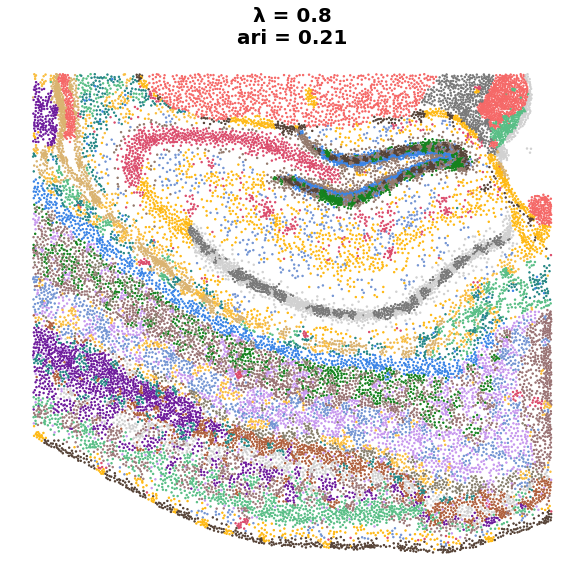

In [66]:
nclust=0
for target_clust in ndoms:
    banksy_dict = initialize_banksy(
        adata,
        coord_keys,
        k_geom,
        nbr_weight_decay=nbr_weight_decay,
        max_m=max_m,
        plt_edge_hist=True,
        plt_nbr_weights=True,
        plt_agf_angles=False,
        plt_theta=False)
    adata.obs['x']=adata.obs['x_centroid']
    adata.obs['y']=adata.obs['y_centroid']
    
    while abs(target_clust-nclust)>1:
        results_df = run_banksy_multiparam(
            adata,
            banksy_dict,
            lambda_list,
            resolutions,
            color_list = spagcn_color+spagcn_color+spagcn_color,
            max_m = max_m,
            filepath = output_folder,
            key = coord_keys,
            pca_dims = pca_dims,
            annotation_key = annotation_key,
            max_labels = num_clusters,
            cluster_algorithm = cluster_algorithm,
            match_labels = False,
            savefig = False,
            add_nonspatial = False,
            variance_balance = False,
        )
        adata_res=results_df.loc[results_df.index[0],'adata']
        res=adata_res.obs.loc[:,['cell_id',results_df.index[0]]]
        res.columns=['cell_id','spatial_domain']
        nclust=len(res['spatial_domain'].unique())
        if nclust>target_clust:
            resolutions[0]=resolutions[0]-0.05
        else:
            resolutions[0]=resolutions[0]+0.05 
    res.to_csv('../../figures/7.spatial_architecture/domains_predicted/ROI1/'+str(target_clust)+'/predicted_BANKSY.csv')
